In [1]:
# -*- coding: utf-8 -*-
import scanpy as sc
import pandas as pd
from sklearn import metrics
import torch

import matplotlib.pyplot as plt
import seaborn as sns

import os
from pathlib import Path
import warnings
warnings.filterwarnings('ignore')


In [ ]:
import TI as spt
import scanpy as sc
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

sc.settings.verbosity = 0
plt.rcParams['figure.dpi'] = 200 #分辨率


In [ ]:
import StPedf

In [ ]:

random_seed = 2025
StPedf.fix_seed(random_seed)

## 1. Prepare ICC adata

Convert tsv files to scanpy adata (the tsv file format was described in 01 notebook).

In [ ]:
adata = sc.read("F:/StPedf/data/ICC/ICC.primary.ST.exp_count.tsv", cache=True)
anno = pd.read_table("F:/StPedf/data/ICC/ICC.primary.ST.annot.tsv")

adata.obs.index = anno["ID"].values
adata.obs["cluster"] = anno["cluster"].values
adata.obsm["spatial"] = anno[["x", "y"]].values
adata.layers["counts"] = adata.X

In [ ]:

sc.pp.filter_genes(adata, min_cells=10)
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)
adata.layers['count'] = adata.X.copy()


sc.pp.highly_variable_genes(adata, flavor="seurat_v3", layer='count', n_top_genes=2000)
adata = adata[:, adata.var['highly_variable']]


#sc.pp.scale(adata)
sc.pp.pca(adata, n_comps=100)


Existing target genes: ['EPCAM', 'CDH1', 'CD44']


<Figure size 2400x1200 with 0 Axes>

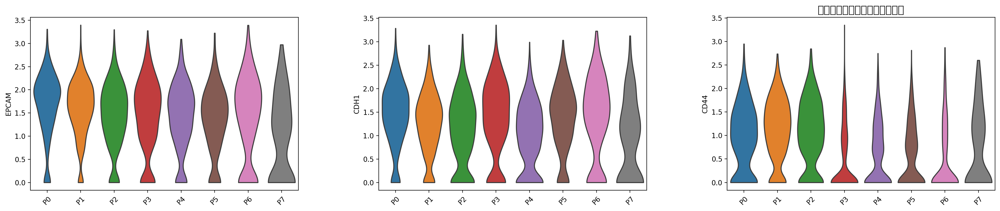

<Figure size 2000x1200 with 0 Axes>

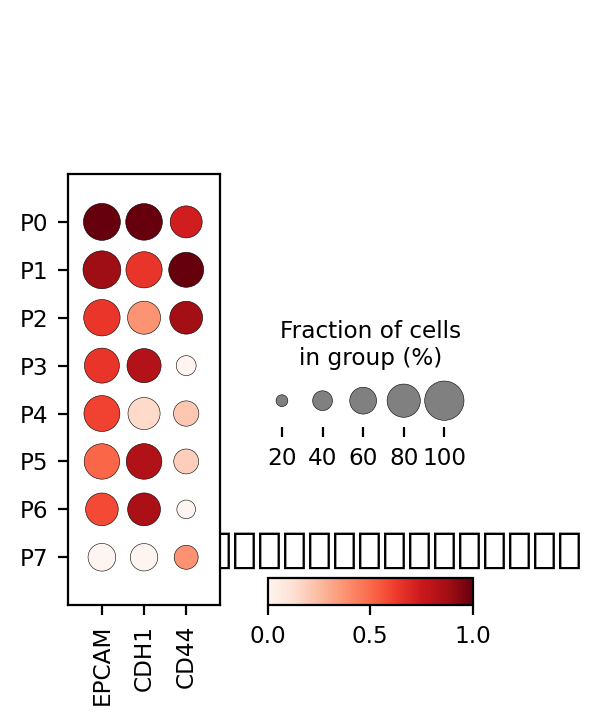

In [ ]:


stemness_genes = ['SOX9', 'EPCAM',"ID1",'CDH1','FOSL1','CD44']
cell_cycle_genes = ['CDK1', 'MKI67']

genes_of_interest = stemness_genes + cell_cycle_genes


present_genes = [gene for gene in genes_of_interest if gene in adata.var_names]
print(f"Existing target genes: {present_genes}")






In [ ]:

p0_cluster = 'P0'  

if p0_cluster not in adata.obs['cluster'].unique():
    print(f"警告：未找到{p0_cluster}亚克隆，请检查命名是否正确")
else:

    adata.obs['is_p0'] = (adata.obs['cluster'] == p0_cluster).astype('category')
    print(f"is_p0的数据类型: {adata.obs['is_p0'].dtype}")
    

    sc.tl.rank_genes_groups(adata, groupby='is_p0', method='wilcoxon', 
                           use_raw=False, key_added='p0_vs_others')
    

    result = adata.uns['p0_vs_others']
    groups = result['names'].dtype.names 
    

    p0_group_name = [g for g in groups if g == 'True'][0]
    

    genes = result['names'][p0_group_name]
    scores = result['scores'][p0_group_name]
    pvals = result['pvals_adj'][p0_group_name]
    

    diff_df = pd.DataFrame({
        'gene': genes,
        'score': scores,
        'adj_pval': pvals
    }, index=range(len(genes))) 

    interest_diff = diff_df[diff_df['gene'].isin(present_genes)]
    print(f"\n{p0_cluster}亚克隆与其他亚克隆的差异表达分析结果：")
    print(interest_diff.sort_values('score', ascending=False))

is_p0的数据类型: category

P0亚克隆与其他亚克隆的差异表达分析结果：
     gene     score      adj_pval
39  EPCAM  9.348786  2.906861e-19
59   CDH1  7.968898  3.597657e-14
73   CD44  6.893232  9.916131e-11


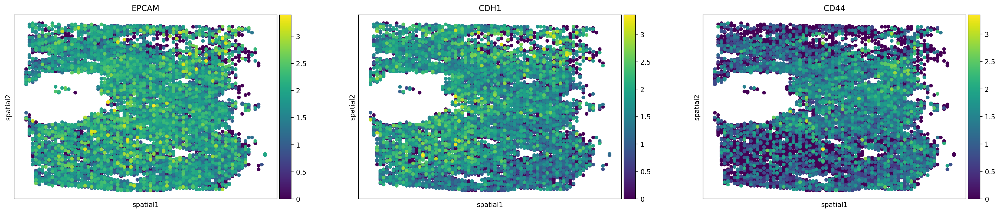

In [ ]:
if len(present_genes) > 0:

    if 'spatial' not in adata.obsm:
        print("警告：adata.obsm中未找到'spatial'坐标，无法绘制空间图")
    else:
      
        adata.obsm['X_spatial'] = adata.obsm['spatial'].copy()
        
    
        sc.pl.scatter(
            adata, 
            basis='spatial', 
            color=present_genes, 
            size=120,
            title=[f"{gene}" for gene in present_genes],
       
            show=True
        )
        


In [ ]:
graph_dict = StPedf.graph_construction(
    adata, 
    12,
    mode='AlphaComplex',  # 显式指定图构建模式
    alpha_n_neighbors=8  # AlphaComplex参数
)
print("空间图构建完成:", graph_dict.keys())


空间图构建完成: dict_keys(['adj_norm', 'adj_label', 'norm_value'])


In [12]:
print(adata.obsm.keys())

KeysView(AxisArrays with keys: spatial, X_pca, X_spatial)


In [ ]:
# gpu
device = 'cuda:0' if torch.cuda.is_available() else 'cpu'


sedr_net = StPedf.Sedr(
    adata.obsm['X_pca'], 
    graph_dict, 
    mode='clustering',
    device=device
)

In [ ]:
sedr_net = StPedf.Sedr(adata.obsm['X_pca'], graph_dict, mode='clustering', device=device)
using_dec = True
n_epochs = 200

if using_dec:
    sedr_net.train_with_dec(N=n_epochs)  
    sedr_feat, _, _, _, _ = sedr_net.process()
    adata.obsm['SEDR'] = sedr_feat

100%|██████████| 200/200 [00:05<00:00, 37.10it/s]


Perform basic preprocessing and visualize spatial data.

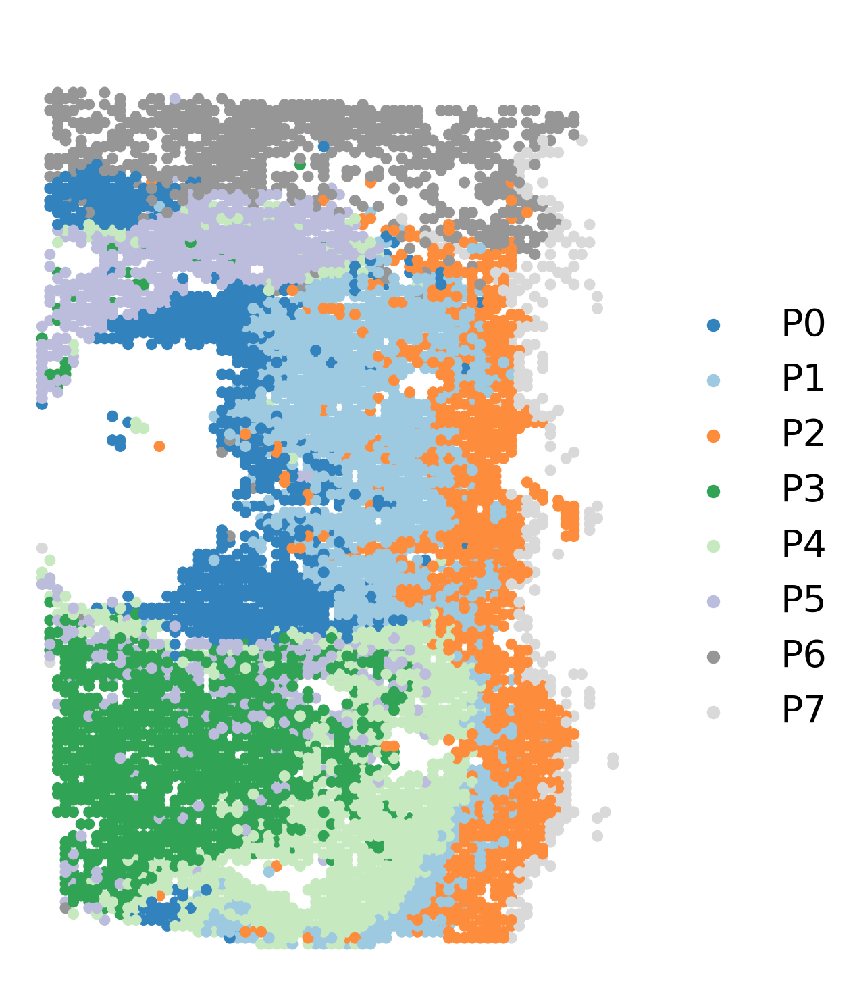

In [15]:
adata.obsm['X_spatial'] = adata.obsm['spatial']
fig, axs = plt.subplots(figsize=(6, 9))
ax = sc.pl.embedding(adata,  basis='X_spatial', show=False, color='cluster', ax=axs, frameon=False, title=' ', palette='tab20c', size=150, legend_fontsize=20)

## 2. Choose start cells

In order to identify potential start regions, multiple factors were considered. We recommend that users manually slecte starting cluster base on prior knowledge within this field. In cases where prior knowledge and biological evidence were not available to support the selection of start cells, we suggested using entropy value. 

In our analysis of the ICC tumor ST data, we found that the P0 cluster demonstrated a relatively high entropy value, indicating more likely to be starting cluster compared to the other clusters. As a result, P0 was selected as the starting cluster for further investigation.

In [16]:
def assess_start_cluster(adata):
    """Assess the entropy value to identify the starting cluster

    Parameters
    ----------
    adata
        Anndata

    Returns
    -------
        adata
    """
    


    cluster_name_list=list()
    entropy_list=list()
    cell_name_list=list()
    for i in range(0,len(adata.obs.index)):
        cell_id=adata.obs.index[i]
        cluster_name=adata.obs['cluster'][i]
        adata_cluster=adata[adata.obs.index.isin([cell_id])]
        matrix = np.array(adata_cluster.X)
        entropy_name=entropy(matrix[0])
        cluster_name_list.append(cluster_name)
        cell_name_list.append(cell_id)
        entropy_list.append(entropy_name)
    df_value=pd.DataFrame({'cluster_name': cluster_name_list,'cell_name':cell_name_list,'entropy':entropy_list})
    adata.obs['entropy']=df_value['entropy'].values

    df_obs=adata.obs
    cluster_order=list(pd.DataFrame(df_obs[['cluster','entropy']].groupby(['cluster']).mean()).sort_values(['entropy'],ascending=False).index)
    df_entropy=pd.DataFrame(df_obs[['cluster','entropy']].groupby(['cluster']).mean()).sort_values(['entropy'],ascending=False)

    df_obs['cluster']= pd.Categorical(df_obs['cluster'], categories=cluster_order, ordered=True)
    print('Cluster order sorted by entropy value: ',list(df_entropy.index))
    df_entropy.index=list(df_entropy.index)
    adata.uns['entropy value']=df_obs
    adata.uns['entropy value order']=df_entropy
    #display(df_entropy)
    return adata

In [17]:
from scipy.stats import entropy

In [18]:
adata = assess_start_cluster(adata)

Cluster order sorted by entropy value:  ['P1', 'P0', 'P2', 'P5', 'P4', 'P3', 'P6', 'P7']


In [19]:
def assess_start_cluster_plot(adata):
    """ Plot the entropy value and Stem Cell Differentiation score of each cluster

    Parameters
    ----------
    adata
        Anndata

    Returns
    -------
        figure
    """
    df_color=pd.DataFrame({"cluster":list(adata.obs['cluster'].cat.categories),"color_name":adata.uns['cluster_colors']})
    df_color.index=list(df_color['cluster'])
    color_palette=dict(zip(df_color['cluster'], df_color['color_name']))
    plt.figure(figsize=(10,9))
    ax1=sns.boxplot(data=adata.uns['entropy value'],x='cluster',y='entropy',linewidth=0.8,
                    palette=color_palette,
                   order=adata.uns['entropy value order'].index,showfliers=False)

    ax1.set_xticklabels(adata.uns['entropy value order'].index.values,rotation=40,ha='center',fontsize=15)
    ax1.set_xlabel(' ')
    ax1.set_ylabel('entropy value',fontsize=20)


    plt.tight_layout()


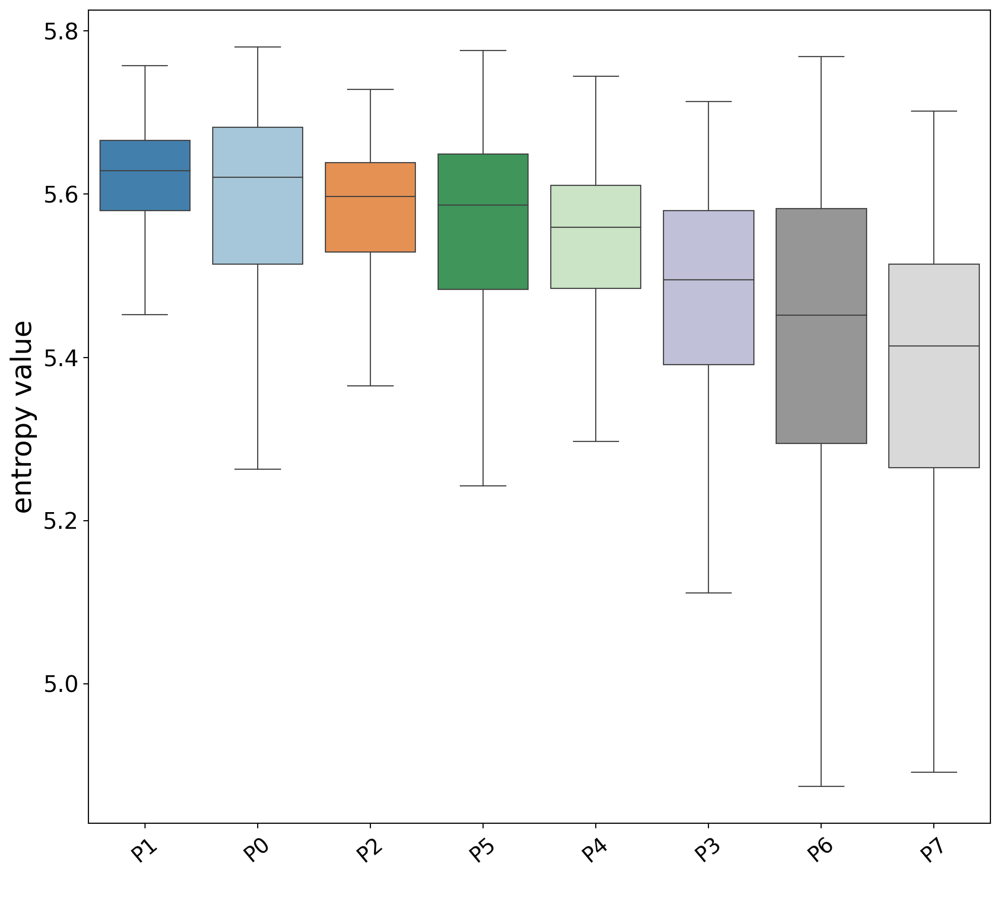

In [20]:
assess_start_cluster_plot(adata)



Since the P0 cluster was distributed across four distinct regions, we used the k-means method with a cluster number of 4 to identify the aggregation points of the P0 cluster. Neighbor cells were then taken as start cells for the trajectory inference.

kmeans cluster centers:
[ 2811.91135734 10332.4099723 ]
[  866.37931034 16618.10344828]
[ 2404.26356589 14189.92248062]
[1654.16666667 4750.        ]


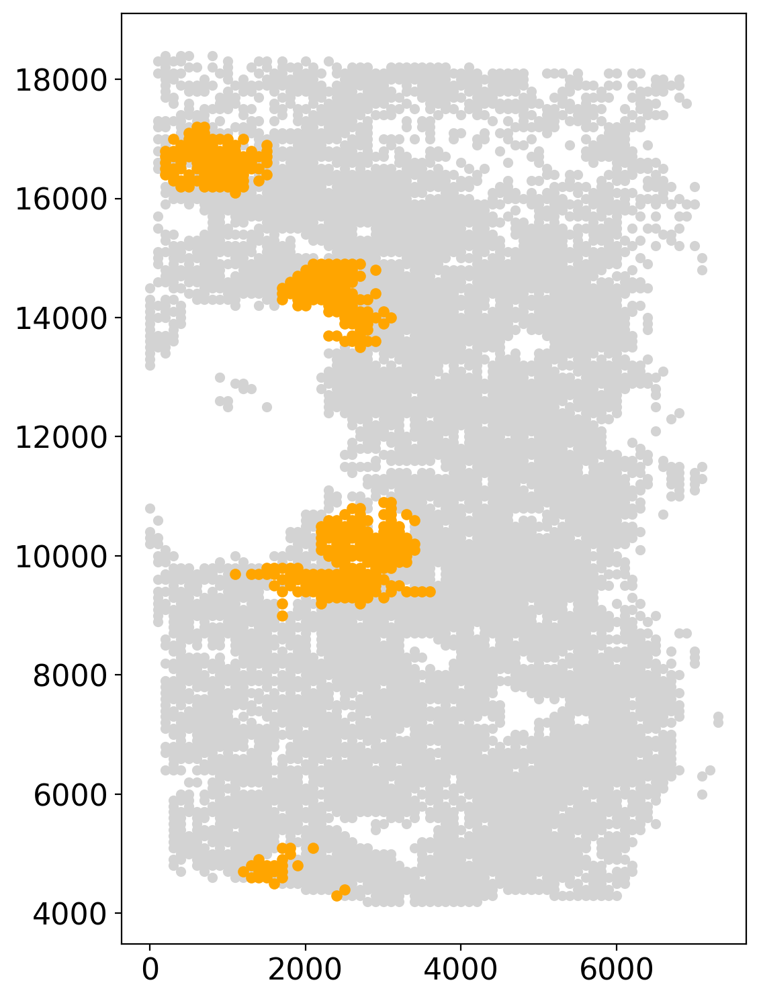

In [21]:
fig, axs = plt.subplots(figsize=(6, 9))
start_cells=spt.set_start_cells(adata,select_way='cell_type',split=True,cell_type='P0',n_neigh=100,n_clusters=4)

plt.scatter(adata.obsm['X_spatial'][:,0],adata.obsm['X_spatial'][:,1],c='#D3D3D3',s=20)
plt.scatter(adata.obsm['X_spatial'][start_cells][:,0],adata.obsm['X_spatial'][start_cells][:,1],c='orange',s=25)

## 3. Calculate cell transition probability

Parameter estimation of alpah1 for gene expression and alpah2 for spatial distance. Calculate cell transition probability based on gene expression matrix and cell spatial coordinate.

In [22]:
from anndata import AnnData
from sklearn.metrics import pairwise_distances
import ot

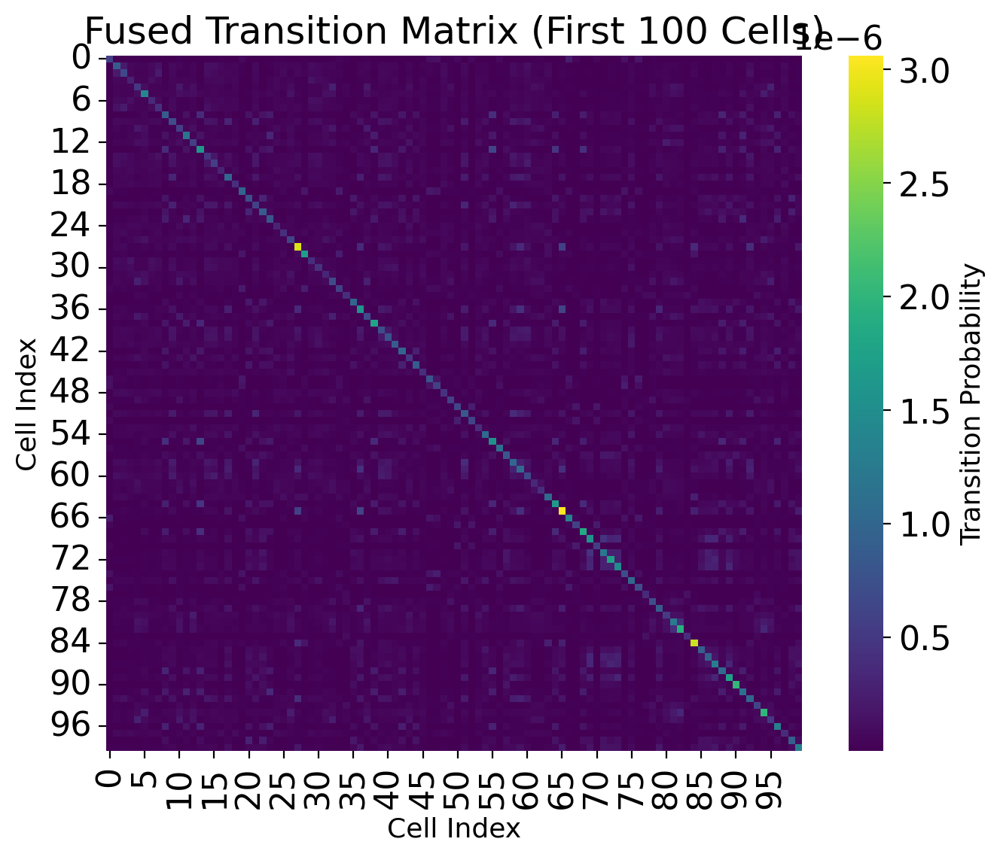

In [ ]:
def construct_fused_transition_matrix(
    adata: AnnData,
    sedr_key: str = 'SEDR',
    spatial_key: str = 'spatial',
    reg: float = 0.1,
    alpha: float = 0.5 
):

    sedr_emb = adata.obsm[sedr_key]
    spatial_coords = adata.obsm[spatial_key]

    sedr_dist = pairwise_distances(sedr_emb)
    spatial_dist = pairwise_distances(spatial_coords)

    sedr_dist /= sedr_dist.max()
    spatial_dist /= spatial_dist.max()

    M = alpha * spatial_dist + (1 - alpha) * sedr_dist

    a = b = np.ones(M.shape[0]) / M.shape[0]
    Gs = ot.sinkhorn(a, b, M, reg=reg)

    return Gs

trans = construct_fused_transition_matrix(
    adata,
    sedr_key='SEDR',
    spatial_key='spatial',
    reg=0.1,
    alpha=0.5
)

adata.obsp["fused_trans"] = trans

plt.figure(figsize=(8, 6))
sns.heatmap(trans[:100, :100], cmap='viridis', square=True, cbar_kws={'label': 'Transition Probability'})
plt.title("Fused Transition Matrix (First 100 Cells)")
plt.xlabel("Cell Index")
plt.ylabel("Cell Index")
plt.show()

## 4. Caculate cell pseudotime

Assign a pseudo-time value to each cell.

In [ ]:

adata.obsp["trans"] = adata.obsp["fused_trans"]

adata.obs["ptime"] = spt.get_ptime(adata, start_cells)

## 5. Calculate vector field velocity.

Calculate vector field velocity by averaging the velocities of each cell and its neighbors.

In [ ]:

adata.obsm['X_spatial'] = adata.obsm['spatial']

In [26]:
adata.uns['E_grid'],adata.uns['V_grid']=spt.get_velocity(adata,basis='spatial',n_neigh_pos=100)

Cell velocities stored in 'velocity_spatial'


## 6. Plot results

Visualization of cell pseudotime and inferred cell trajectory.

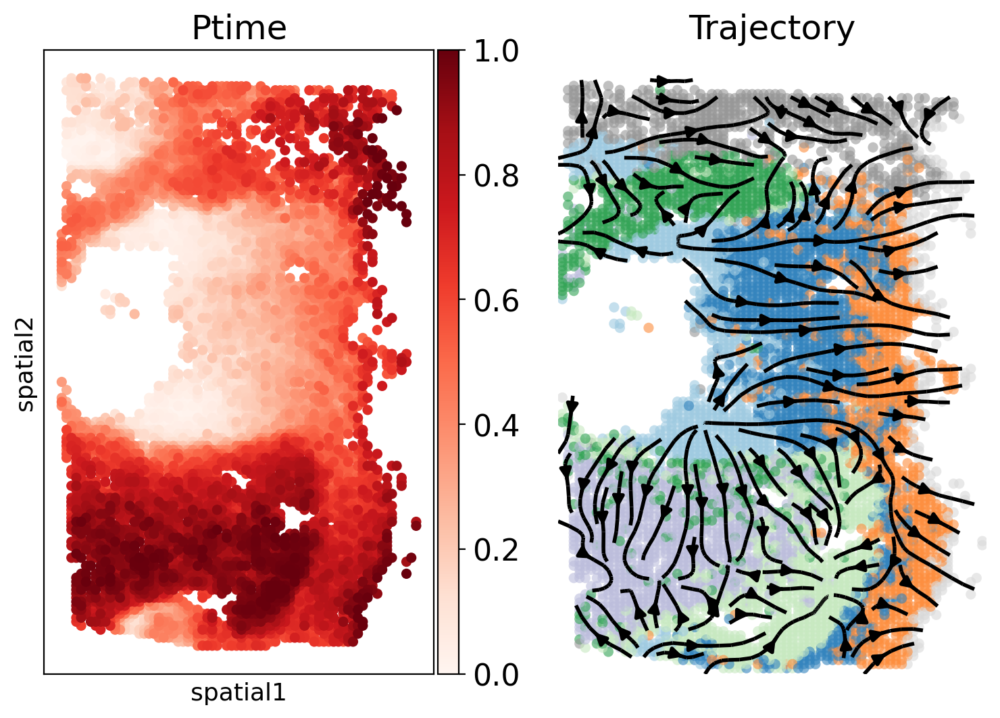

In [27]:
fig, axs = plt.subplots(ncols=2, nrows=1, figsize=(9, 6))

sc.pl.embedding(adata, basis='spatial', color='ptime', show=False, ax=axs[0], color_map='Reds', title='Ptime',size=120)
vf_velocity = sc.pl.embedding(adata, basis='spatial', show=False, ax=axs[1],color='cluster', legend_loc=None, frameon=False, title='Trajectory', alpha=0.6, size=120)
vf_velocity.streamplot(adata.uns['E_grid'][0], adata.uns['E_grid'][1], adata.uns['V_grid'][0], adata.uns['V_grid'][1], color='black', linewidth=2,density=1.2,arrowsize=1.2)

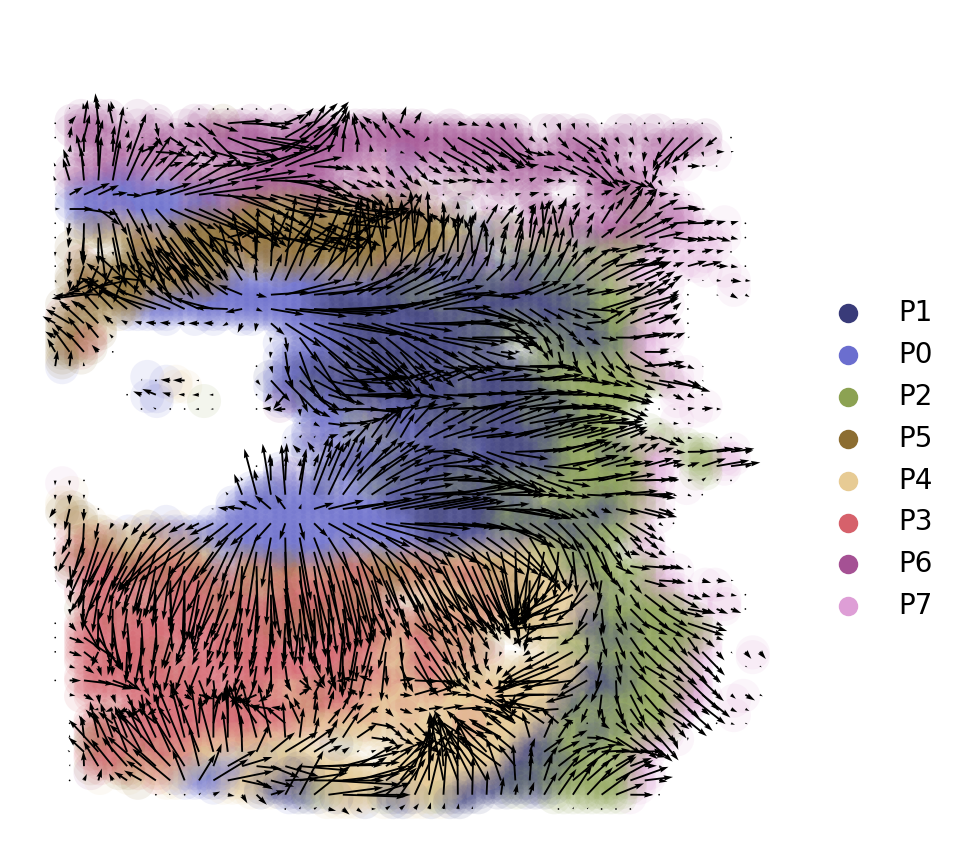

In [ ]:
scale_factor = 2.0  
V_grid_scaled = [adata.uns['V_grid'][0] * scale_factor, 
                 adata.uns['V_grid'][1] * scale_factor]

fig, axs = plt.subplots(figsize=(5, 5))
sc.pl.embedding(adata, basis='spatial', show=False, title=' ', 
                color='cluster', ax=axs, frameon=False, 
                palette='tab20b', legend_fontweight='normal', alpha=0.1, size=600)

axs.quiver(adata.uns['E_grid'][0], adata.uns['E_grid'][1], 
           V_grid_scaled[0], V_grid_scaled[1], 
           scale=0.003, 
           )

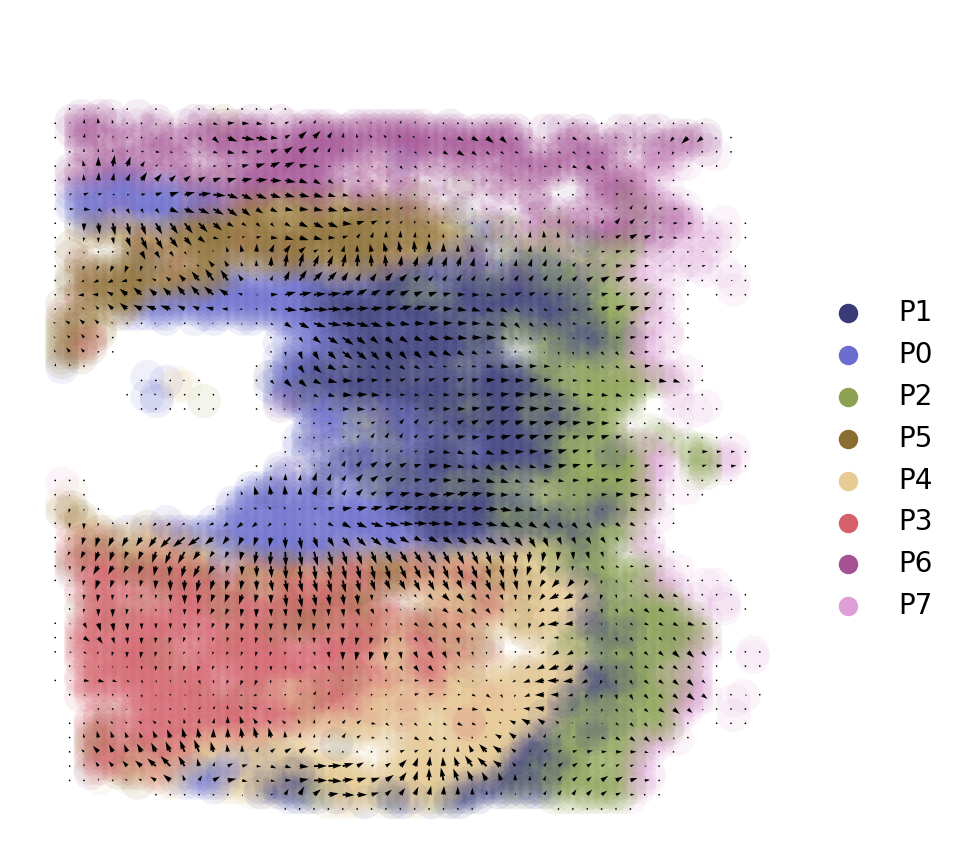

In [29]:
fig, axs = plt.subplots(figsize=(5, 5))
scale_factor = 5.0 
sc.pl.embedding(adata, basis='spatial',show=False,title=' ',color='cluster',ax=axs,frameon=False,palette='tab20b',legend_fontweight='normal',alpha=0.1,size=600)
axs.quiver(adata.uns['E_grid'][0],adata.uns['E_grid'][1],adata.uns['V_grid'][0],adata.uns['V_grid'][1],scale=0.008)

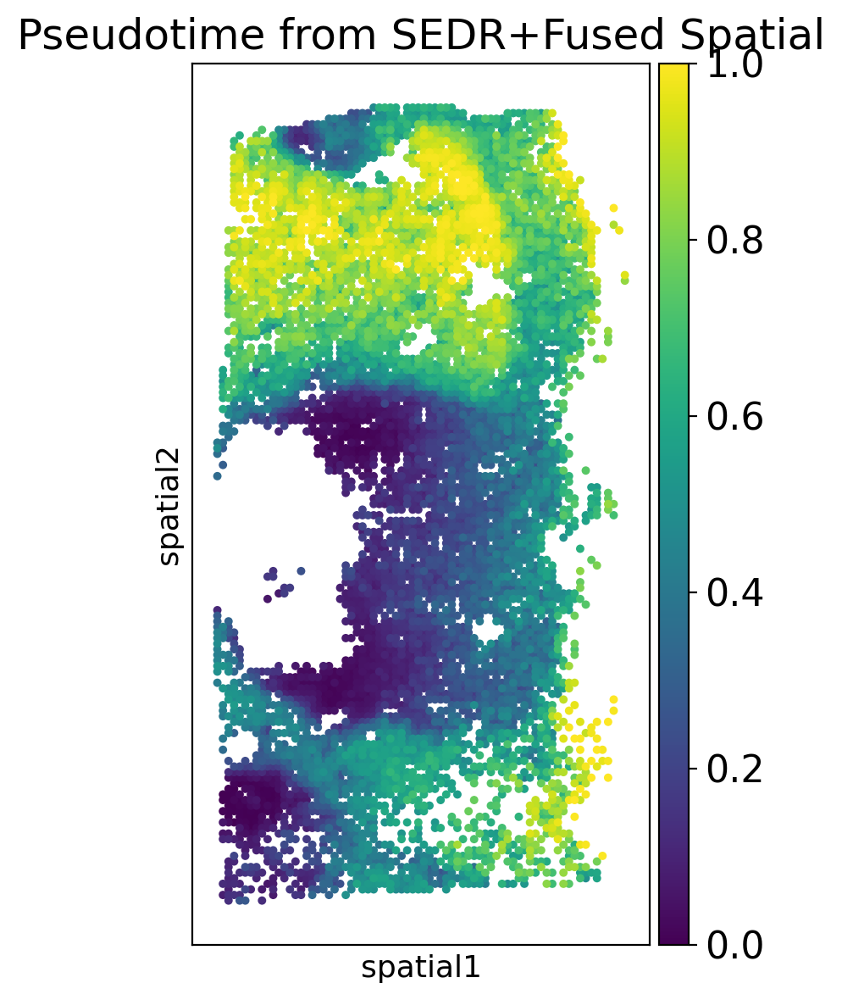

In [ ]:
fig, ax = plt.subplots(figsize=(6, 6))
sc.pl.spatial(adata, color='ptime', title='Pseudotime from SEDR+Fused Spatial', 
              size=1.5, spot_size=100, ax=ax, show=False) 
plt.tight_layout()
plt.show()

In [31]:
VecFld = spt.VectorField(adata, basis="spatial")

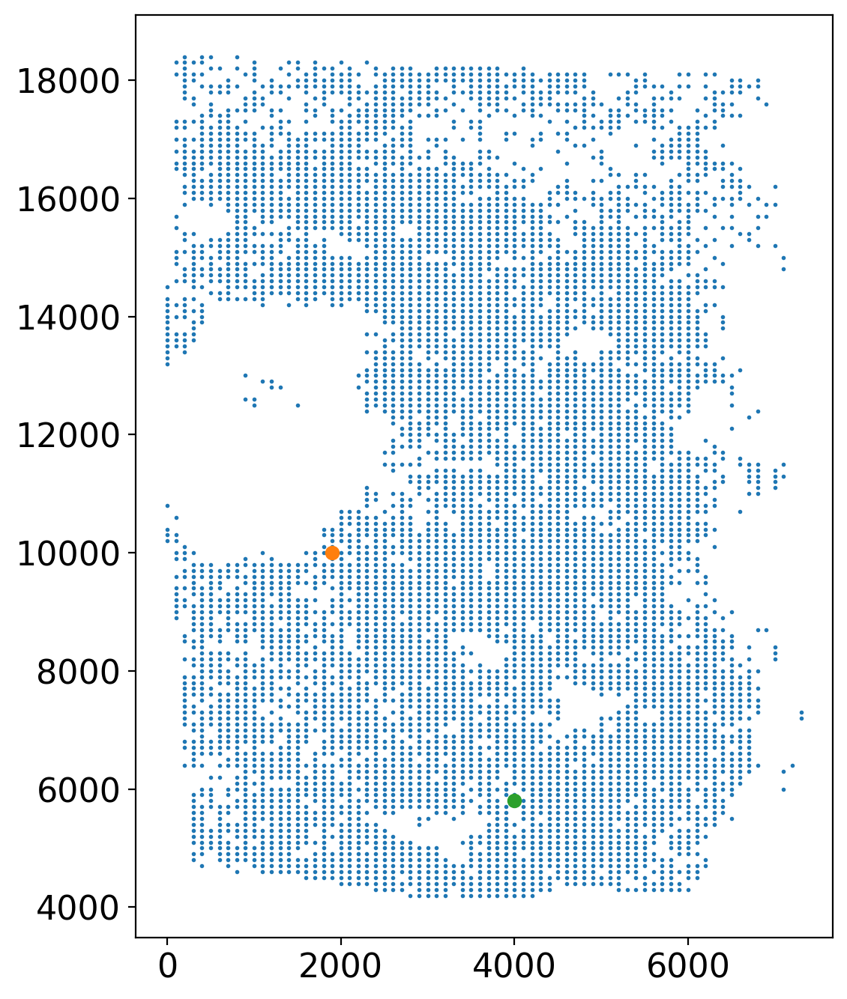

In [32]:
fig, axs = plt.subplots(ncols=1, nrows=1, figsize=(6, 8))

LAP_start_point=[1900,10000]
LAP_end_point=[4000,5800]
LAP_start_cell = spt.nearest_neighbors(LAP_start_point, adata.obsm["spatial"])[0][0]
LAP_end_cell = spt.nearest_neighbors(LAP_end_point, adata.obsm["spatial"])[0][0]

plt.scatter(*adata.obsm["X_spatial"].T, s=1)
plt.scatter(*adata[LAP_start_cell].obsm["X_spatial"].T)
plt.scatter(*adata[LAP_end_cell].obsm["X_spatial"].T)

In [33]:
sc.pp.neighbors(adata, use_rep="spatial", key_added="spatial", n_neighbors=100)

In [34]:
import scipy.sparse as sp
adata.obsp["fused_trans"] = sp.csr_matrix(trans)

In [35]:
lap = spt.least_action(
    adata,
    init_cells=adata.obs_names[LAP_start_cell],
    target_cells=adata.obs_names[LAP_end_cell],
    vecfld=VecFld,
    basis="spatial",
    adj_key="fused_trans",
    EM_steps=5,
    n_points=20,
)

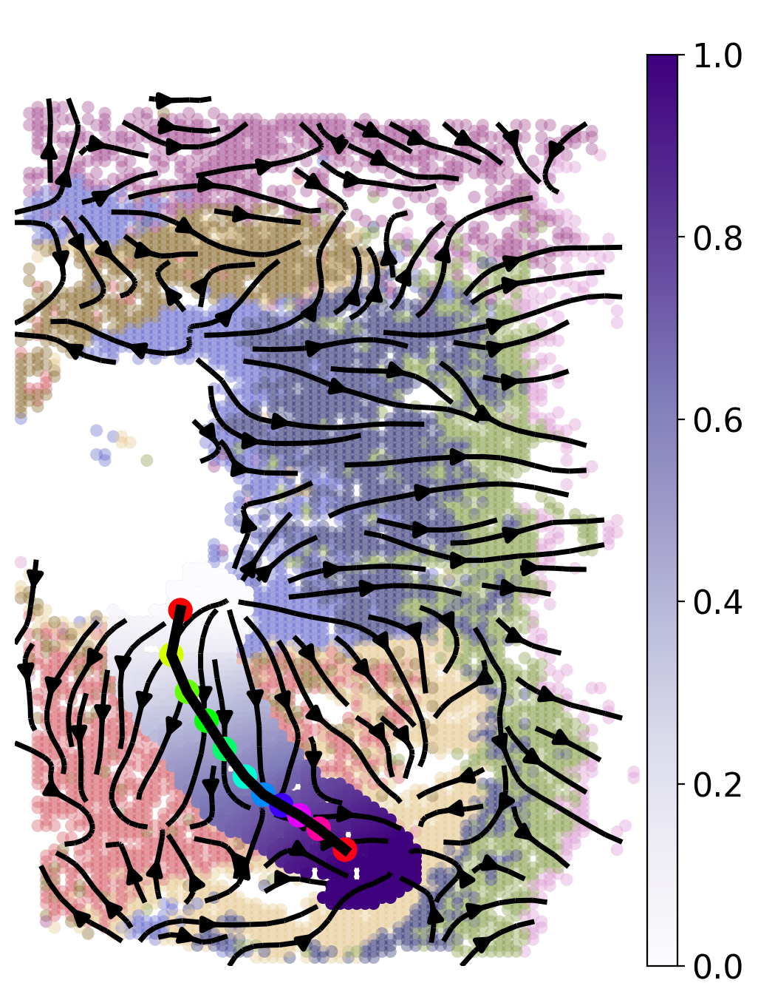

In [36]:
LAP_ptime,LAP_nbrs=spt.lap.map_cell_to_LAP(adata)
sub_adata=adata[LAP_nbrs,:]
sub_adata.obs['ptime']=LAP_ptime
sub_adata=sub_adata[np.argsort(sub_adata.obs["ptime"].values), :].copy()

fig, ax = plt.subplots(figsize=(6,8))
plt.axis('off')
ax = sc.pl.embedding(adata,  basis='spatial',color='cluster',show=False,ax=ax,frameon=False,legend_loc=None,alpha=0.4,size=150)
ax.streamplot(adata.uns['E_grid'][0], adata.uns['E_grid'][1], adata.uns['V_grid'][0], adata.uns['V_grid'][1],density=1.2,color='black',linewidth=2.5,arrowsize=1.5,minlength=0.1,maxlength=0.8)
ax = spt.plot_least_action_path(adata,basis='spatial',ax=ax,point_size=120,linewidth=5)
sc.pl.embedding(sub_adata, basis='spatial',ax=ax, color="ptime", cmap="Purples",frameon=True,size=150,title=' ')

In [37]:
sub_adata_path = sub_adata[sub_adata.obs["cluster"].isin(["P0", "P3", "P4"])]
sub_adata_path = spt.filter_gene(sub_adata_path, min_exp_prop=0.1, hvg_gene=5000)

clusters ordered by ptime:  ['P0', 'P3', 'P4']
Cell number	704
Gene number	340


In [38]:
df_res  = spt.ptime_gene_GAM(sub_adata_path,core_number=5)

Genes number fitted by GAM model:   340


In [39]:
df_sig_res = df_res.loc[(df_res['model_fit']>0.15) & (df_res['fdr']<0.05)]
sort_exp_sig = spt.order_trajectory_genes(sub_adata_path,df_sig_res,cell_number=20)

Finally selected 44 genes.


Show example of pseudotime-dependent genes.

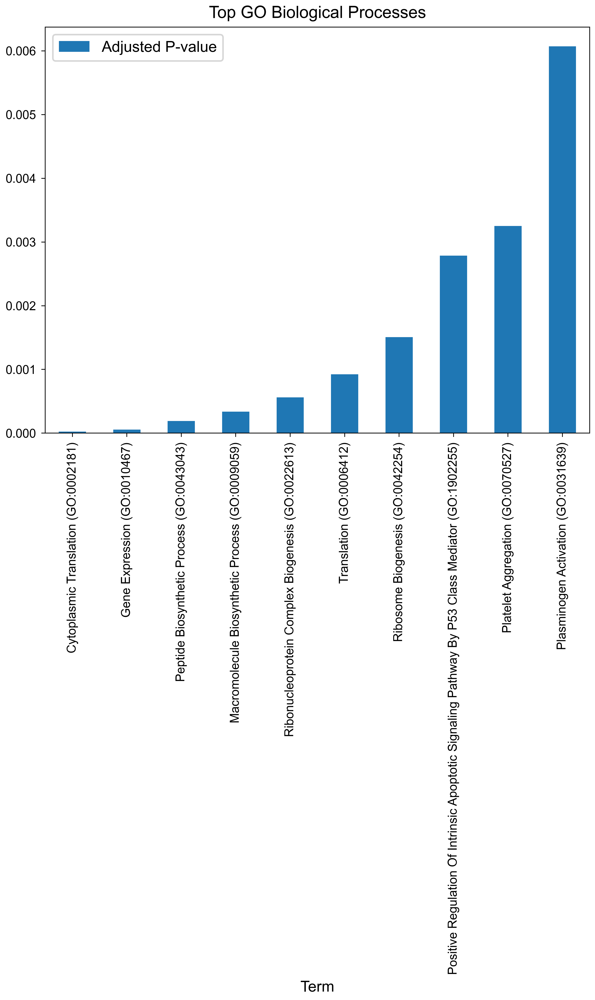

In [ ]:
import gseapy as gp

sig_genes = df_sig_res.index.tolist()

go_results = gp.enrichr(gene_list=sig_genes,
                        gene_sets=['GO_Biological_Process_2023'],
                        organism='Human')
kegg_results = gp.enrichr(gene_list=sig_genes,
                          gene_sets=['KEGG_2021_Human'],
                          organism='Human')
go_results.results.head(10).plot.bar(x='Term', y='Adjusted P-value')
plt.title('Top GO Biological Processes')
plt.tight_layout()

谱系1

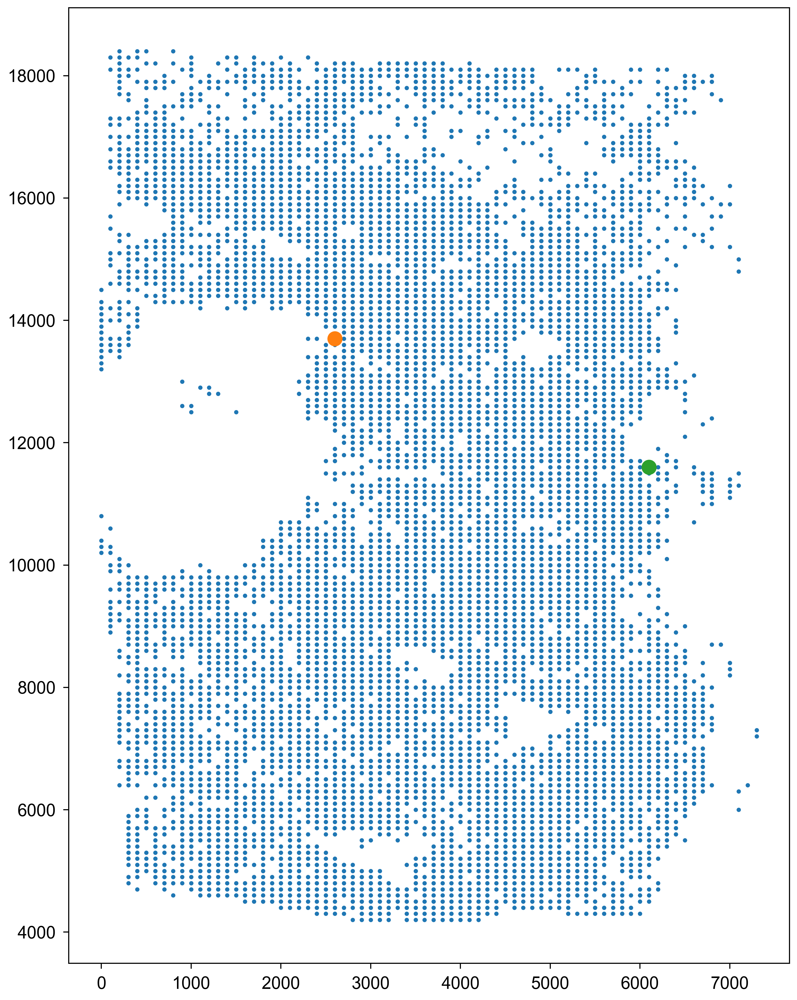

In [45]:
fig, axs = plt.subplots(ncols=1, nrows=1, figsize=(6, 8))
LAP_start_point = [2600, 13700]
LAP_end_point = [6100, 11700]
LAP_start_cell = spt.nearest_neighbors(LAP_start_point, adata.obsm["spatial"])[0][0]
LAP_end_cell = spt.nearest_neighbors(LAP_end_point, adata.obsm["spatial"])[0][0]

plt.scatter(*adata.obsm["spatial"].T, s=1)
plt.scatter(*adata[LAP_start_cell].obsm["spatial"].T)
plt.scatter(*adata[LAP_end_cell].obsm["spatial"].T)

In [46]:
sc.pp.neighbors(adata, use_rep="spatial", key_added="spatial", n_neighbors=100)

In [47]:
import scipy.sparse as sp
adata.obsp["fused_trans"] = sp.csr_matrix(trans)

In [48]:
lap = spt.least_action(
    adata,
    init_cells=adata.obs_names[LAP_start_cell],
    target_cells=adata.obs_names[LAP_end_cell],
    vecfld=VecFld,
    basis="spatial",
    adj_key="fused_trans",
    EM_steps=5,
    n_points=20,
)

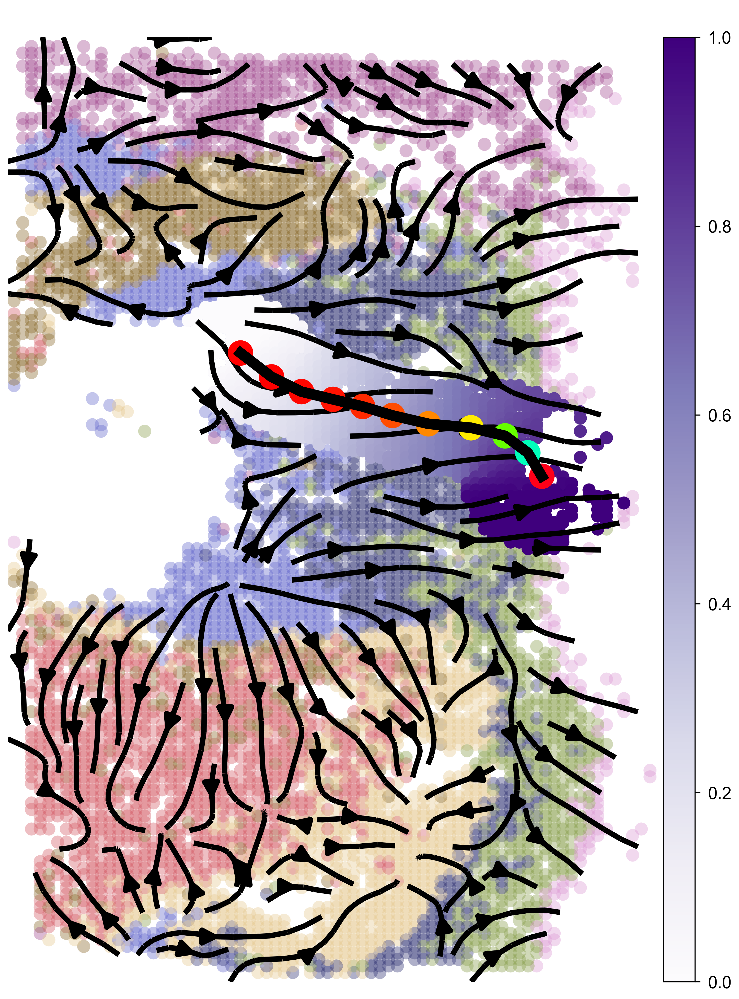

In [49]:
LAP_ptime,LAP_nbrs=spt.lap.map_cell_to_LAP(adata)
sub_adata=adata[LAP_nbrs,:]
sub_adata.obs['ptime']=LAP_ptime
sub_adata=sub_adata[np.argsort(sub_adata.obs["ptime"].values), :].copy()

fig, ax = plt.subplots(figsize=(6,8))
plt.axis('off')
ax = sc.pl.embedding(adata,  basis='spatial',color='cluster',show=False,ax=ax,frameon=False,legend_loc=None,alpha=0.4,size=150)
ax.streamplot(adata.uns['E_grid'][0], adata.uns['E_grid'][1], adata.uns['V_grid'][0], adata.uns['V_grid'][1],density=1.2,color='black',linewidth=2.5,arrowsize=1.5,minlength=0.1,maxlength=0.8)
ax = spt.plot_least_action_path(adata,basis='spatial',ax=ax,point_size=120,linewidth=5)
sc.pl.embedding(sub_adata, basis='spatial',ax=ax, color="ptime", cmap="Purples",frameon=True,size=150,title=' ')

In [50]:
sub_adata_path = sub_adata[sub_adata.obs["cluster"].isin(["P0", "P1", "P2","P7"])]
sub_adata_path = spt.filter_gene(sub_adata_path, min_exp_prop=0.1, hvg_gene=5000)

clusters ordered by ptime:  ['P0', 'P1', 'P2', 'P7']
Cell number	676
Gene number	341


In [51]:
df_res  = spt.ptime_gene_GAM(sub_adata_path,core_number=5)

Genes number fitted by GAM model:   341


In [52]:
df_sig_res = df_res.loc[(df_res['model_fit']>0.15) & (df_res['fdr']<0.05)]
sort_exp_sig = spt.order_trajectory_genes(sub_adata_path,df_sig_res,cell_number=20)

Finally selected 30 genes.


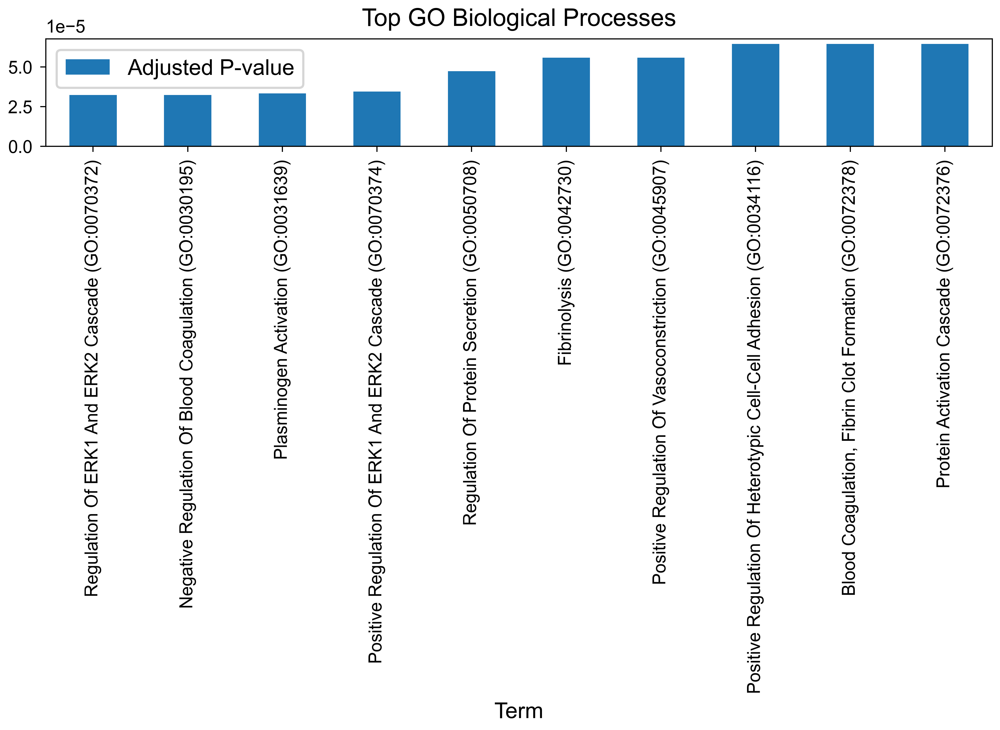

In [ ]:
import gseapy as gp

sig_genes = df_sig_res.index.tolist()

go_results = gp.enrichr(gene_list=sig_genes,
                        gene_sets=['GO_Biological_Process_2023'],
                        organism='Human')

kegg_results = gp.enrichr(gene_list=sig_genes,
                          gene_sets=['KEGG_2021_Human'],
                          organism='Human')

go_results.results.head(10).plot.bar(x='Term', y='Adjusted P-value')
plt.title('Top GO Biological Processes')
plt.tight_layout()

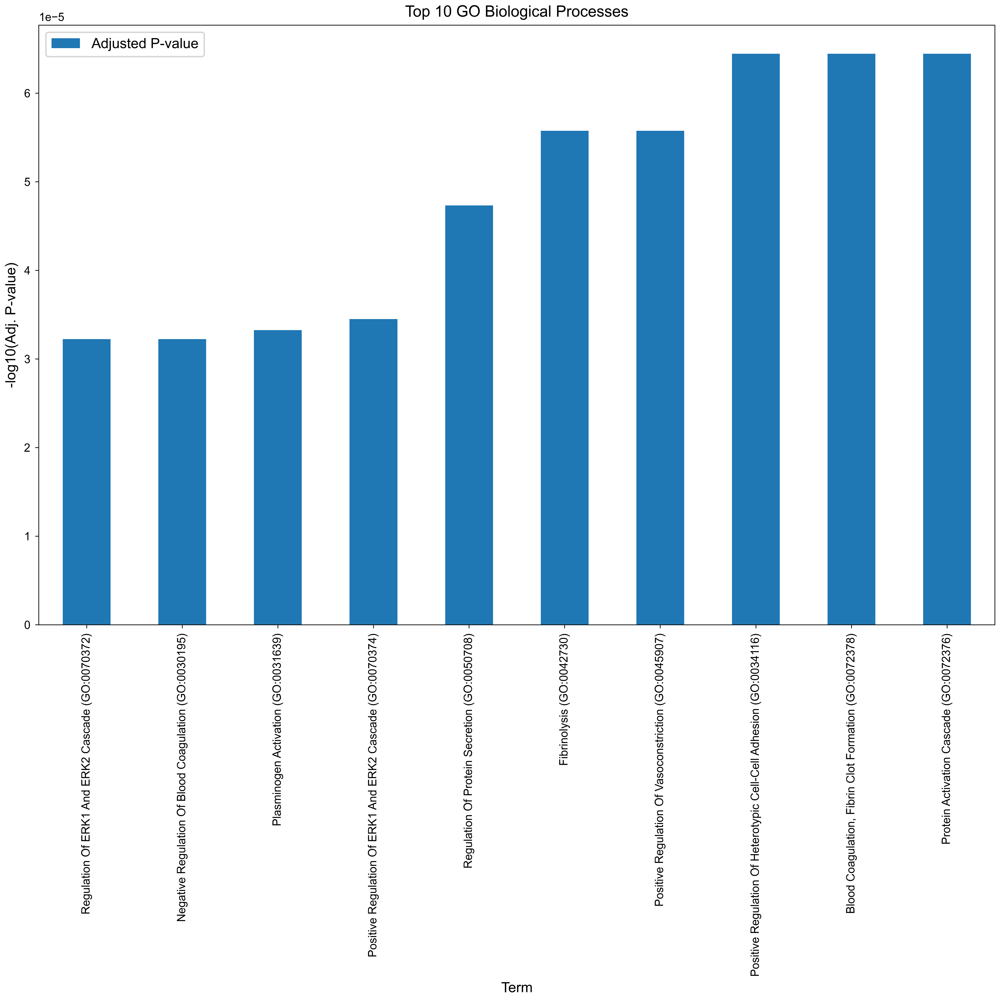

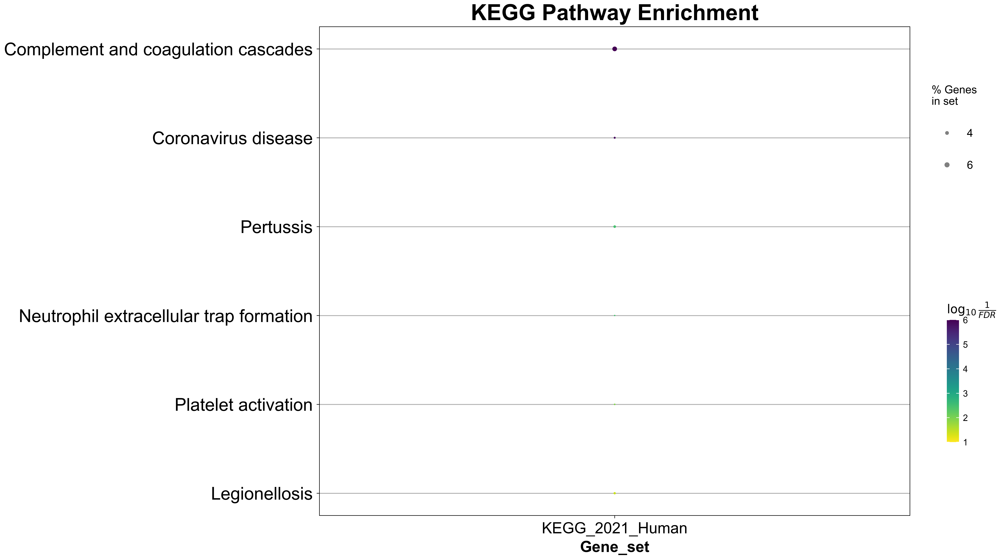

In [ ]:
import gseapy as gp

sig_genes = df_sig_res.index.tolist() 

go_results = gp.enrichr(
    gene_list=sig_genes,
    gene_sets=['GO_Biological_Process_2023'],
    organism='Human',
    cutoff=0.05 
)

kegg_results = gp.enrichr(
    gene_list=sig_genes,
    gene_sets=['KEGG_2021_Human'],
    organism='Human',
    cutoff=0.05
)

go_plot = go_results.results.head(10).plot.bar(
    x='Term', 
    y='Adjusted P-value',
    title='Top 10 GO Biological Processes',
    figsize=(10, 10),
    color='#1f77b4'
)
plt.ylabel('-log10(Adj. P-value)')
plt.tight_layout()
plt.savefig('go_pathways.png', dpi=300)

kegg_plot = gp.dotplot(
    kegg_results.results,
    column="Adjusted P-value",
    x='Gene_set',  # 通路名称
    size=10,
    top_term=10,
    figsize=(12, 8),
    title='KEGG Pathway Enrichment'
)
plt.savefig('kegg_pathways.png', dpi=300)

In [ ]:
import matplotlib.patches as patches

lineage_terms = df.groupby('lineage')['GO_term'].apply(list).to_dict()
lineage_pvalues = df.groupby('lineage')['-log10_adjusted_p'].apply(list).to_dict()

fig, ax = plt.subplots(figsize=(8, 8))
ax.set_aspect('equal')

outer_radius = 1.0
inner_radius = 0.6
color_palette = sns.color_palette('husl', len(lineage_terms))
for i, (lineage, terms) in enumerate(lineage_terms.items()):
    pvalues = lineage_pvalues[lineage]
    angle = np.linspace(0, 2 * np.pi, len(terms) + 1)
    for j in range(len(terms)):
        wedge = patches.Wedge((0, 0), outer_radius, angle[j], angle[j + 1],
                              width=outer_radius - inner_radius,
                              color=color_palette[i])
        ax.add_artist(wedge)
plt.legend(lineage_terms.keys(), loc='upper right')
plt.title('Functional Annotation of Pseudotime - Dependent Genes by Lineage')
plt.show()

NameError: name 'df' is not defined

谱系3

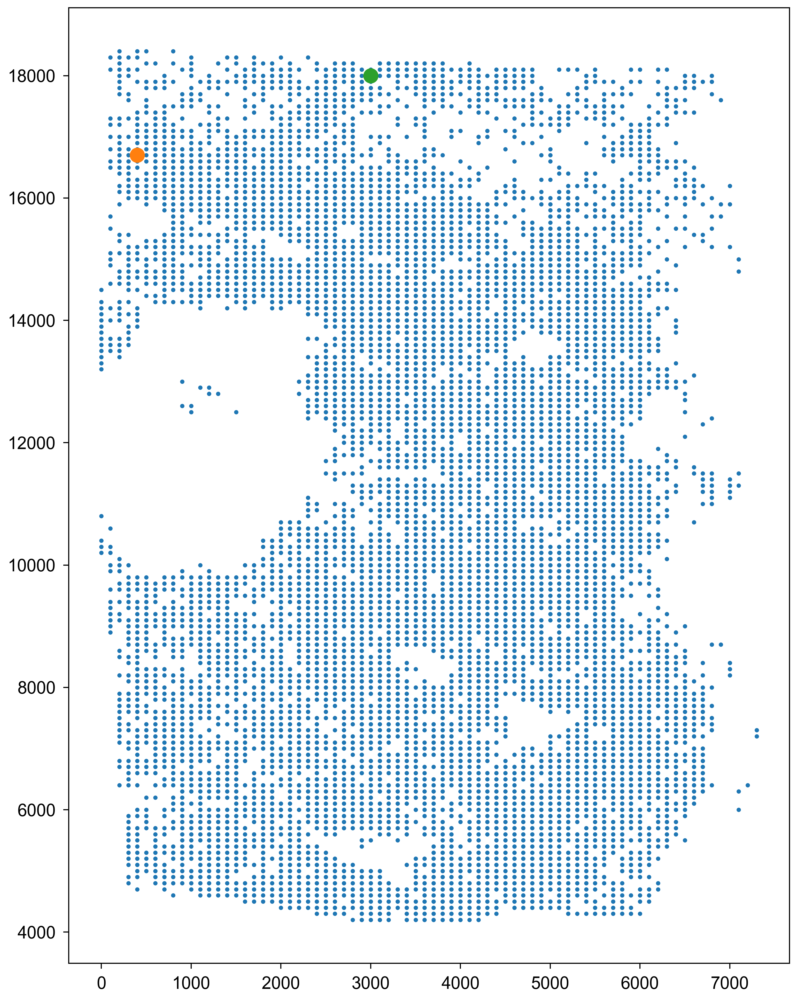

In [59]:
fig, axs = plt.subplots(ncols=1, nrows=1, figsize=(6, 8))
LAP_start_point = [400, 16700]
LAP_end_point = [3000, 18000]
LAP_start_cell = spt.nearest_neighbors(LAP_start_point, adata.obsm["spatial"])[0][0]
LAP_end_cell = spt.nearest_neighbors(LAP_end_point, adata.obsm["spatial"])[0][0]

plt.scatter(*adata.obsm["spatial"].T, s=1)
plt.scatter(*adata[LAP_start_cell].obsm["spatial"].T)
plt.scatter(*adata[LAP_end_cell].obsm["spatial"].T)

In [60]:
sc.pp.neighbors(adata, use_rep="spatial", key_added="spatial", n_neighbors=100)

In [61]:
import scipy.sparse as sp
adata.obsp["fused_trans"] = sp.csr_matrix(trans)

In [62]:
lap = spt.least_action(
    adata,
    init_cells=adata.obs_names[LAP_start_cell],
    target_cells=adata.obs_names[LAP_end_cell],
    vecfld=VecFld,
    basis="spatial",
    adj_key="fused_trans",
    EM_steps=5,
    n_points=20,
)

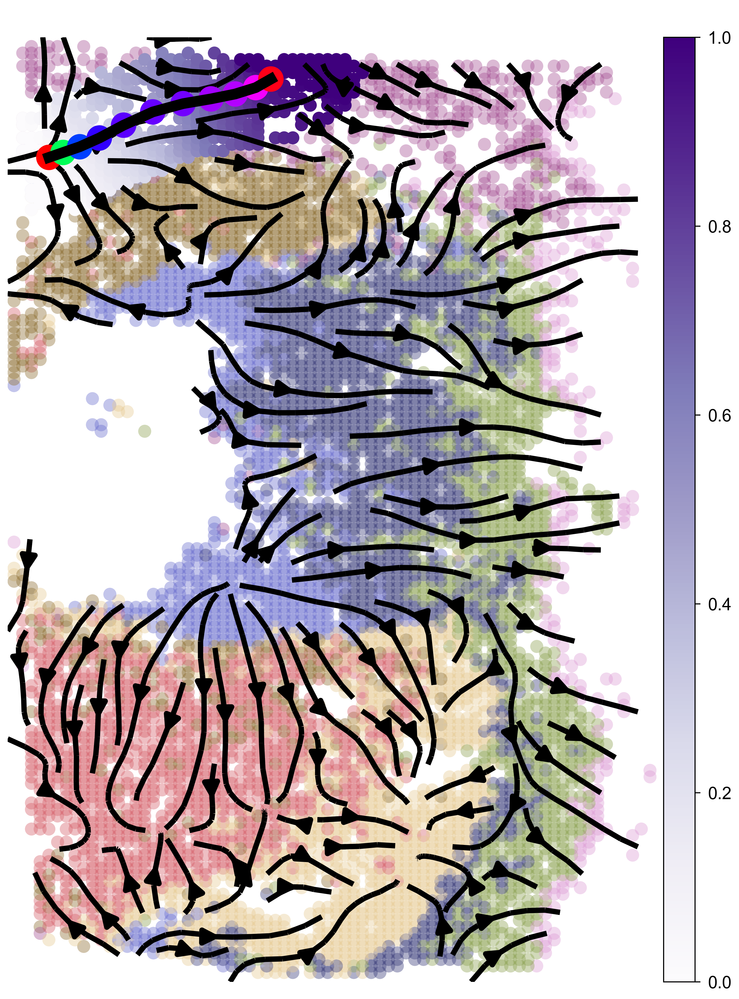

In [63]:
LAP_ptime,LAP_nbrs=spt.lap.map_cell_to_LAP(adata)
sub_adata=adata[LAP_nbrs,:]
sub_adata.obs['ptime']=LAP_ptime
sub_adata=sub_adata[np.argsort(sub_adata.obs["ptime"].values), :].copy()

fig, ax = plt.subplots(figsize=(6,8))
plt.axis('off')
ax = sc.pl.embedding(adata,  basis='spatial',color='cluster',show=False,ax=ax,frameon=False,legend_loc=None,alpha=0.4,size=150)
ax.streamplot(adata.uns['E_grid'][0], adata.uns['E_grid'][1], adata.uns['V_grid'][0], adata.uns['V_grid'][1],density=1.2,color='black',linewidth=2.5,arrowsize=1.5,minlength=0.1,maxlength=0.8)
ax = spt.plot_least_action_path(adata,basis='spatial',ax=ax,point_size=120,linewidth=5)
sc.pl.embedding(sub_adata, basis='spatial',ax=ax, color="ptime", cmap="Purples",frameon=True,size=150,title=' ')

In [64]:
sub_adata_path = sub_adata[sub_adata.obs["cluster"].isin(["P0", "P5", "P6"])]
sub_adata_path = spt.filter_gene(sub_adata_path, min_exp_prop=0.1, hvg_gene=5000)

clusters ordered by ptime:  ['P5', 'P0', 'P6']
Cell number	426
Gene number	346


In [65]:
df_res  = spt.ptime_gene_GAM(sub_adata_path,core_number=5)

Genes number fitted by GAM model:   346


In [66]:
df_sig_res = df_res.loc[(df_res['model_fit']>0.15) & (df_res['fdr']<0.05)]
sort_exp_sig = spt.order_trajectory_genes(sub_adata_path,df_sig_res,cell_number=20)

Finally selected 19 genes.


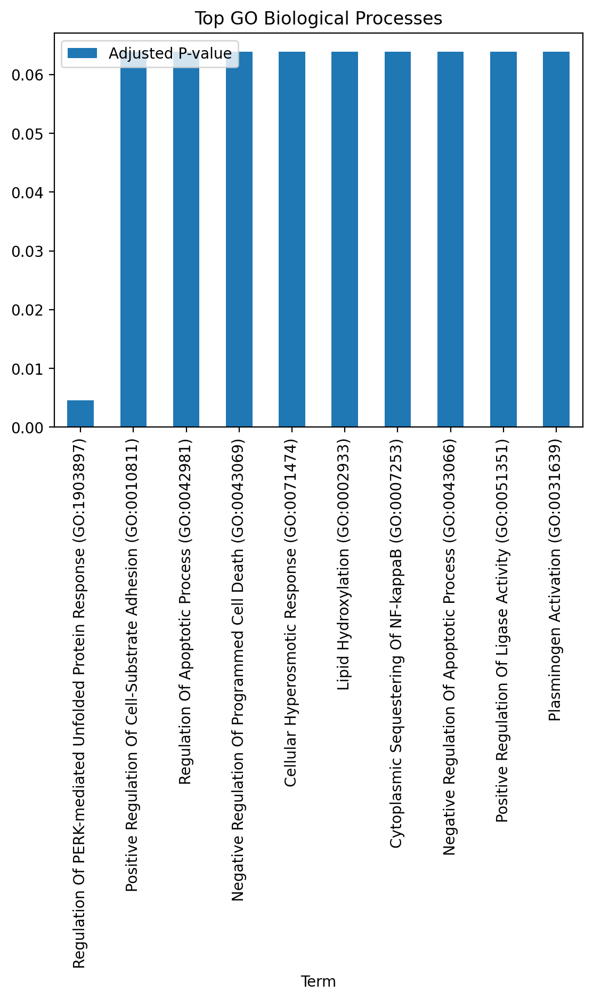

In [ ]:
import gseapy as gp
sig_genes = df_sig_res.index.tolist()
go_results = gp.enrichr(gene_list=sig_genes,
                        gene_sets=['GO_Biological_Process_2023'],
                        organism='Human')
kegg_results = gp.enrichr(gene_list=sig_genes,
                          gene_sets=['KEGG_2021_Human'],
                          organism='Human')
go_results.results.head(10).plot.bar(x='Term', y='Adjusted P-value')
plt.title('Top GO Biological Processes')
plt.tight_layout()

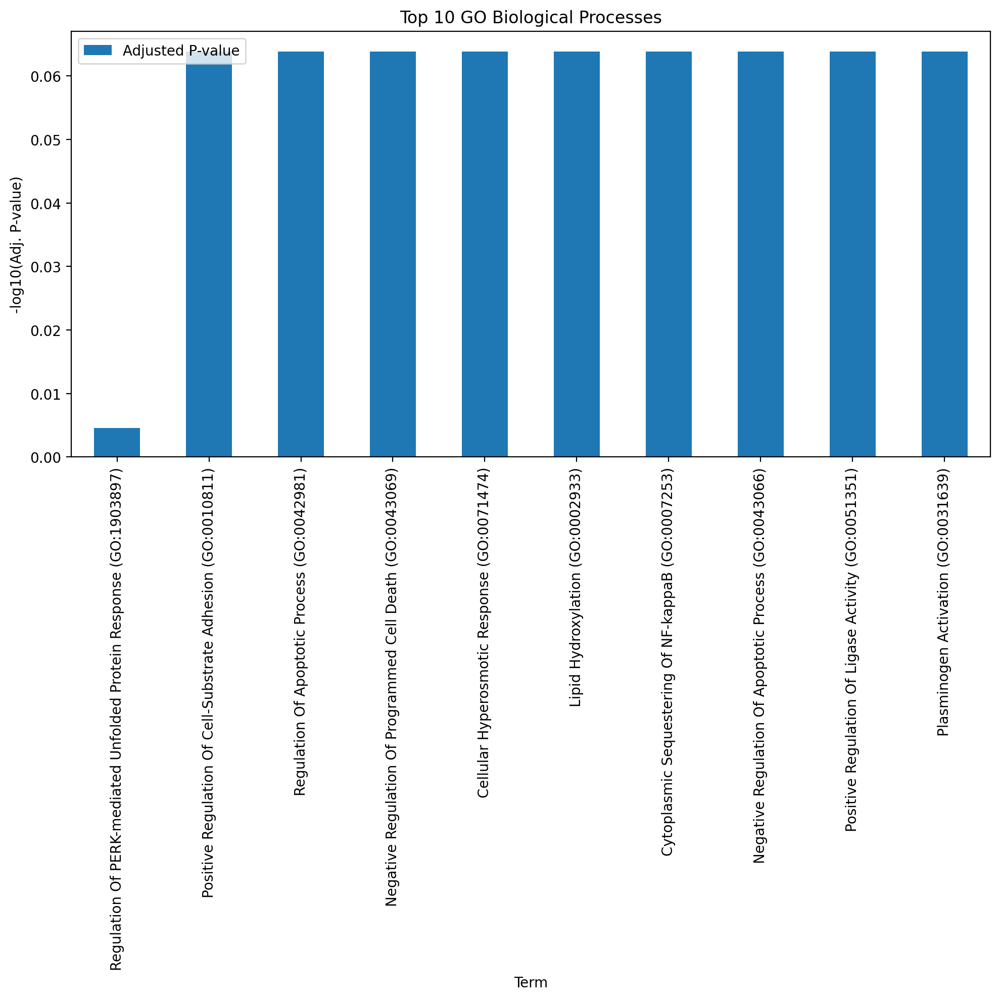

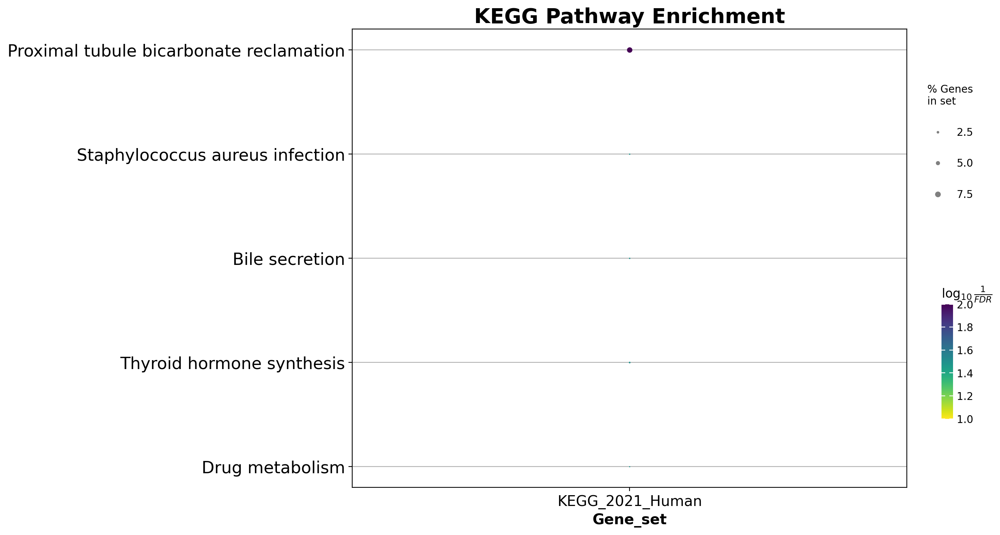

In [ ]:
import gseapy as gp

sig_genes = df_sig_res.index.tolist() 

go_results = gp.enrichr(
    gene_list=sig_genes,
    gene_sets=['GO_Biological_Process_2023'],
    organism='Human',
    cutoff=0.05 
)

kegg_results = gp.enrichr(
    gene_list=sig_genes,
    gene_sets=['KEGG_2021_Human'],
    organism='Human',
    cutoff=0.05
)

go_plot = go_results.results.head(10).plot.bar(
    x='Term', 
    y='Adjusted P-value',
    title='Top 10 GO Biological Processes',
    figsize=(10, 10),
    color='#1f77b4'
)
plt.ylabel('-log10(Adj. P-value)')
plt.tight_layout()
plt.savefig('go_pathways.png', dpi=300)

kegg_plot = gp.dotplot(
    kegg_results.results,
    column="Adjusted P-value",
    x='Gene_set', 
    size=10,
    top_term=10,
    figsize=(12, 8),
    title='KEGG Pathway Enrichment'
)
plt.savefig('kegg_pathways.png', dpi=300)